# Forecasting Time Series

A **time series** is a sequence of data points collected or recorded at successive points in time, usually at equally spaced intervals (e.g. the number of daily active users on a website, the hourly temperature in a city, home’s daily power consumption, the trajectories of nearby cars, etc.). Time series data are characterized by temporal ordering, meaning that the order in which data points are arranged is crucial and can be analized to **learns past patterns** in the data, in order to be able to use that knowledge to **forecast the future**, assuming that past patterns still hold. For example, we can consider the dataset of the number of passengers that will ride on bus and rail the next day from the Chicago Transit Authority, available at the [Chicago Data Portal](https://data.cityofchicago.org/Transportation/CTA-Ridership-Daily-Boarding-Totals/6iiy-9s97/about_data): 

In [4]:
import urllib.request

url = "https://www.dropbox.com/s/wiww3a55sgifhb3/ridership.zip?dl=1"
u = urllib.request.urlopen(url)
data = u.read()
u.close()

with open("./data/ridership.zip", "wb") as f :
   f.write(data)

In [5]:
import zipfile

with zipfile.ZipFile("./data/ridership.zip","r") as zip_ref:
    zip_ref.extractall("./data")

We’ll start by loading and cleaning up the data. We load the CSV file, set short column names, sort the rows by date, remove the redundant total column, and drop duplicate rows.

In [6]:
import pandas as pd

df = pd.read_csv("./data/ridership/CTA_-_Ridership_-_Daily_Boarding_Totals.csv", parse_dates=["service_date"])

df.columns = ["date", "day_type", "bus", "rail", "total"]
df = df.sort_values("date").set_index("date")
df = df.drop("total", axis=1)
df = df.drop_duplicates()

Now let’s check what the first few rows look like:

In [9]:
df.head()

,day_type,bus,rail
date,,,
2001-01-01,U,297192,126455
2001-01-02,W,780827,501952
2001-01-03,W,824923,536432
2001-01-04,W,870021,550011
2001-01-05,W,890426,557917


The day_type column contains W for Weekdays, A for Saturdays, and U for Sundays or holidays.

This is a **time series**, data with values at different time steps at regular intervals. More specifically, since there are multiple values per time step, this is called a **multivariate time series**. Predicting future values (**forecasting**) is the most typical task when dealing with time series. Other tasks include **imputation** (filling in missing past values), **classification**, **anomaly detection**, and more. Let’s plot the bus and rail ridership figures over a few months in 2019, to see what it looks like:

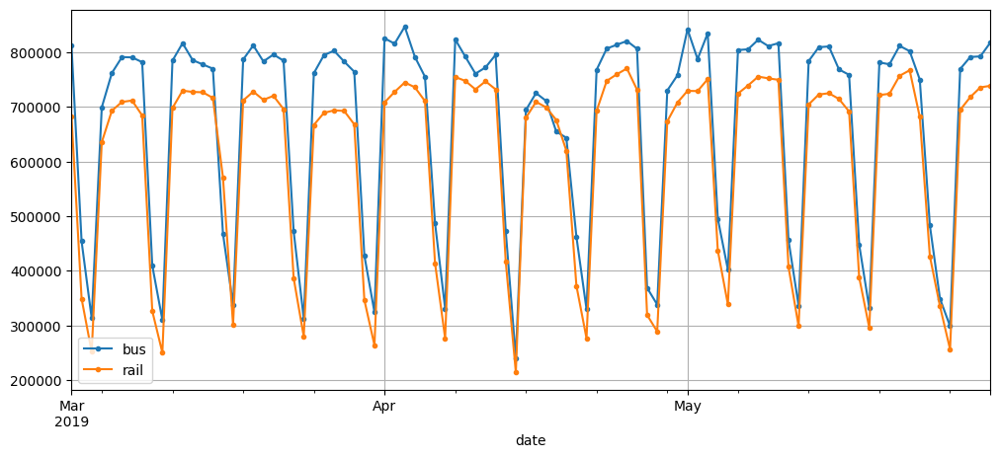

In [11]:
import matplotlib.pyplot as plt

df["2019-03":"2019-05"].plot(grid=True, marker=".", figsize=(12, 5))
plt.show()

We can see that a similar pattern is clearly repeated every week (**seasonality**), and it’s so strong in this case that forecasting tomorrow’s ridership by just copying the values from a week earlier will yield reasonably good results. This is called **naive forecasting**: simply copying a past value to make our forecast, and it is often a good baseline. To visualize the naive forecasts, let’s overlay the same time serie lagged by one week (shifted toward the right) using dotted lines: 

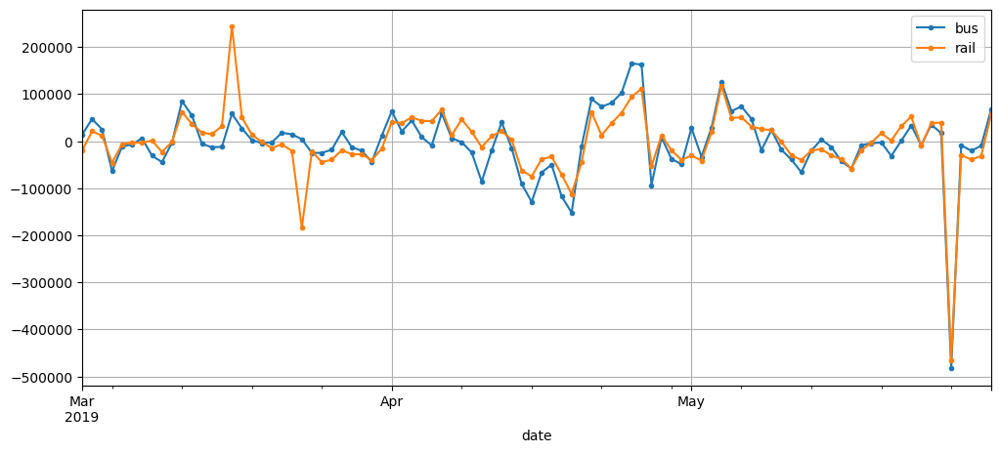

In [13]:
diff_7 = df[["bus", "rail"]].diff(7)["2019-03":"2019-05"]
diff_7.plot(grid=True, marker=".", figsize=(12, 5)) 
plt.show()

Notice how closely the lagged time series track the actual time series. When a time series is correlated with a lagged version of itself, we say that the time series is **autocorrelated**. As you can see, most of the differences are fairly small, except at the end of May. Maybe there was a holiday at that time? Let’s check the day_type column:

In [216]:
list(df.loc["2019-05-25":"2019-05-27"]["day_type"])

['A', 'U', 'U']

There was a long weekend back then: the Monday was the Memorial Day holiday. We could use this information to improve our forecasts, but for
now let’s measure the **Mean Absolute Error (MAE)** over the three-month period to get a rough idea:

In [14]:
diff_7.abs().mean()

bus     43915.608696
rail    42143.271739
dtype: float64

It’s hard to tell at a glance how good or bad this is, so let’s put the forecast errors into perspective by dividing them by the target values:

In [15]:
targets = df[["bus", "rail"]]["2019-03":"2019-05"]
(diff_7 / targets).abs().mean()

bus     0.082938
rail    0.089948
dtype: float64

This is called the **Mean Absolute Percentage Error (MAPE)**. It’s interesting to note that the MAE for the rail forecasts looks slightly better than the MAE for the bus forecasts, while the opposite is true for the MAPE. That’s because the bus ridership is larger than the rail ridership, so naturally the forecast errors are also larger, but when we put the errors into perspective, it turns out that the bus forecasts are actually slightly better than the rail forecasts. The MAE, MAPE, and MSE are among the most common metrics used to evaluate forecasts. As always, choosing the right metric depends on the task.

Looking at the time series, there doesn’t appear to be any significant monthly seasonality, but let’s check whether there’s any yearly seasonality. Pandas resample() methoid is powerful, because it lets us to convert time series data with one time interval into time series data with different time intervals. We look at the data from 2001 to 2019 and we plot also a 12-month rolling average to visualize long-term trends:

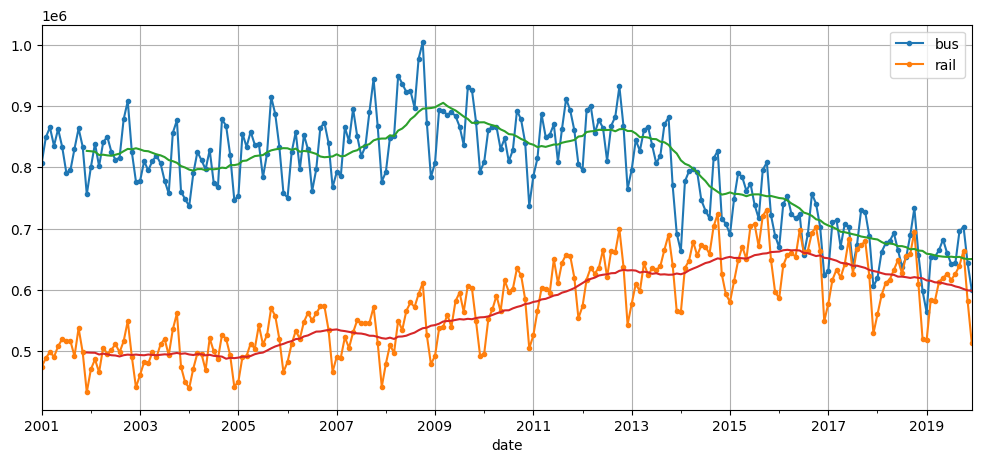

In [18]:
period = slice("2001", "2019")

df_monthly = df.loc[ : , df.columns!='day_type']

# compute the mean for each month
df_monthly = df_monthly.resample(rule='ME').mean() 

fig, ax = plt.subplots(figsize=(12, 5))
rolling_average_12_months = df_monthly[period].rolling(window=12).mean()

df_monthly[period].plot(ax=ax, marker=".")
rolling_average_12_months.plot(ax=ax, grid=True, legend=False)

plt.show()

There’s some yearly seasonality as well, although it is noisier than the weekly one, and more visible for the rail series than the bus series. we see peaks and troughs at roughly the same dates each year. Let’s check what we get if we plot the 12-month difference:

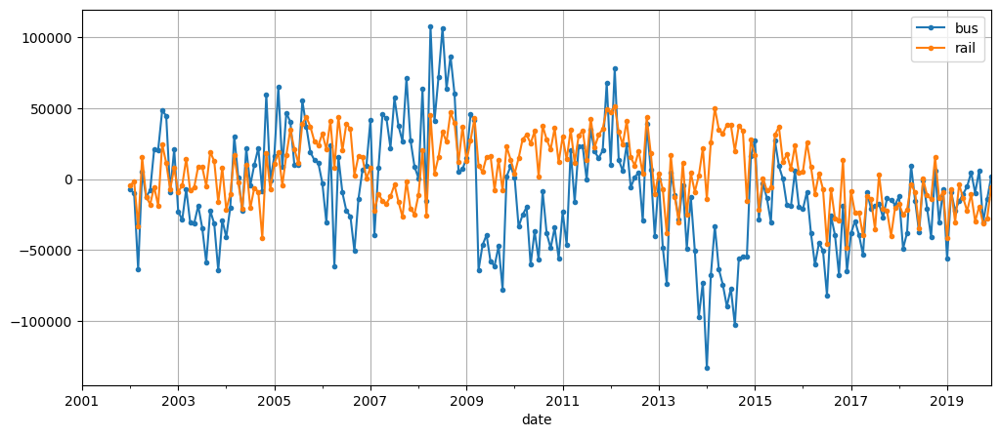

In [19]:
df_monthly.diff(12)[period].plot(grid=True, marker=".", figsize=(12, 5))
plt.show()

Notice how differencing removed the yearly seasonality and also removed the long-term trends **Differencing** is a common technique used to remove trend and seasonality from a time series: it’s easier to study a **stationary time series**, meaning one whose statistical properties remain constant over time, without any seasonality or trends.

## Moving Average Models

The **Autoregressive Moving Average (ARMA)** model was developed by Herman Wold in the 1930s: it computes the forecasts using a simple weighted average of lagged values and corrects these forecasts by adding a moving average of the last few forecast errors: 

$\displaystyle \hat{y}_{(t)} = \sum\limits_{i=1}^{p}{\alpha_i y_{(t-i)} } + \sum\limits_{i=1}^{q}{ \theta_i \epsilon_{(t-i)} }$

where

$\displaystyle \epsilon_{(t)} = y_{(t)} - \hat{y}_{(t)}$

The first sum is the weighted sum of the past p values of the time series and it is the autoregressive component of the model. The second sum is the weighted sum over the past q forecast errors and it is the moving average component of the model. The numbers p and q are hyperparameters to determines how far back into the past the model should look. 

Notice that this approach assumes that the time series is stationary. If it is not, **differencing** may help. Differencing over a single time step will produce an **approximation of the derivative** of the time series: it will give the slope of the series at each time step eliminating any linear trend. For example, if you apply one-step differencing to the series [3, 5, 7, 9, 11], we get the differenced series [2, 2, 2, 2]. However, if the original time series has a quadratic trend, a single round of differencing will not be enough. For example, the series [1, 4, 9, 16, 25, 36] becomes [3, 5, 7, 9, 11] after one round, but if we run differencing for a second time, then we get [2, 2, 2, 2]. Generally, running d consecutive rounds of differencing computes an approximation of the d order derivative of the time series and can eliminate polynomial trends up to degree d. This hyperparameter d is called the **order of integration**. This is the main contribution of the **Autoregressive Integrated Moving Average (ARIMA) model** introduced in 1970.

One last algorithms is the **Seasonal ARIMA (SARIMA)** model: it add to the ARIMA model a seasonal component for a given frequency (e.g., weekly). It has a total of seven hyperparameters: p, d, and q hyperparameters as ARIMA, plus additional P, D, and Q hyperparameters to model the seasonal pattern, and the period of the seasonal pattern s.

We can fit a SARIMA model to the rail time series, and use it to make a forecast. We can use the statsmodels library, which includes the ARMA model and its variants:

In [221]:
from statsmodels.tsa.arima.model import ARIMA

origin, today = "2019-01-01", "2019-05-31"
rail_series = df.loc[origin:today]["rail"].asfreq("D")

order = (1, 0, 0) #p=1, d=0, q=0
seasonal_order = (0, 1, 1, 7) #P=0, D=1, Q=1, and s=7. 

model = ARIMA(rail_series, order=order, seasonal_order=seasonal_order)
model = model.fit()

In [222]:
y_pred = model.forecast()  # returns 427758.6
print("SARIMA prediction: ", y_pred[0])

print("Actual value: ", df["rail"].loc["2019-06-01"])
print("Naive prediction: ", df["rail"].loc["2019-05-25"])

SARIMA prediction:  427758.62631318445
Actual value:  379044
Naive prediction:  426932


The forecast is pretty bad, actually slightly worse than naive forecasting (426932). However to check the performance of the model, we need to forecast for several days (we can be just unlucky that day) and compute the MAE over the period:

In [223]:
origin, start_date, end_date = "2019-01-01", "2019-03-01", "2019-05-31"
time_period = pd.date_range(start_date, end_date)
rail_series = df.loc[origin:end_date]["rail"].asfreq("D")
y_preds = []
for today in time_period.shift(-1):
    # train on data up to "today"
    model = ARIMA(rail_series[origin:today], order=order, seasonal_order=seasonal_order)
    model = model.fit()
    y_pred = model.forecast()[0]
    y_preds.append(y_pred)

y_preds = pd.Series(y_preds, index=time_period)
mae = (y_preds - rail_series[time_period]).abs().mean()

print("SARIMA MAE: ", mae)

SARIMA MAE:  32040.72008847262


The MAE is significantly lower than the MAE we got with naive forecasting Although the model is not perfect, it still beats naive forecasting by a large margin, on average. We can displays the SARIMA forecasts compared with the actual values:

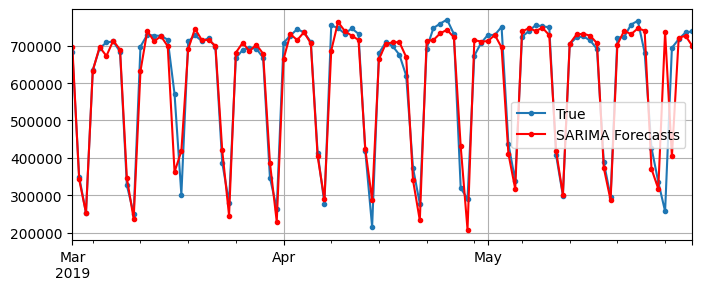

In [224]:
fig, ax = plt.subplots(figsize=(8, 3))
rail_series.loc[time_period].plot(label="True", ax=ax, marker=".", grid=True)
ax.plot(y_preds, color="r", marker=".", label="SARIMA Forecasts")
plt.legend()
plt.show()

## Memory Cells

In **feedforward neural networks**, the activations flow only in one direction, from the input layer to the output layer. A RNN looks like a feedforward network, except it also has **connections pointing backward**. Let’s look at the simplest possible RNN, composed of one neuron receiving inputs, producing an output, and sending that output back to itself:

<img src="./images/simple-rnn.png" width="80">

At each time step (**frame**), the recurrent neuron receives the inputs as well as its own output from the previous time step. Since there is no previous output at the first time step, it is generally set to 0. We can represent this tiny network against the time axis: 

<img src="./images/unrolling.png" width="400">

This is called **unrolling the network through time**: it’s the same recurrent neuron represented once per time step.

We can create a layer of recurrent neurons: 

<img src="./images/rnn-layer.png" width="400">

At each time step, every neuron receives both the input vector and the output vector from the
previous time step. Each recurrent neuron has **two sets of weights**: one for the inputs and the
other for the outputs of the previous time step. Let’s call these weight vectors:

$w_x$ and $w_{\hat{y}}$

If we consider the whole recurrent layer, we can place all the weight vectors in two matrices:

$W_x$ and $W_{\hat{y}}$

The output vector of the whole recurrent layer can then be computed as we might expect

$\hat{y}_{(t)} = \phi(W_x^T x_{(t)}+ W_{\hat{y}}^T\hat{y}_{(t-1)} + b)$

where b is the bias vector and $\phi$ is the activation function (e.g., ReLU⁠).

Just as with feedforward neural networks, we can compute a recurrent layer’s output in one shot for an entire mini-batch by placing all the inputs at time
step t into an input matrix

$\hat{Y}_{(t)} = \phi(X_{(t)}W_x + \hat{Y}_{(t-1)} W_{\hat{y}} + b)$

Notice that: 

- $\hat{Y}_{(t)}$ is a function of $X_{(t)}$ and $\hat{Y}_{(t-1)}$
- $\hat{Y}_{(t-1)}$ is a function of $X_{(t-1)}$ and $\hat{Y}_{(t-2)}$
- $\hat{Y}_{(t-2)}$ is a function of $X_{(t-2)}$ and $\hat{Y}_{(t-3)}$
- and so on. 

This makes $\hat{Y}_{(t)}$ a function of all the inputs since time $t=0$ and we could say it has **a form of memory**. A part of a neural network that preserves some state across time steps is called **memory cell** and it's state is a function of the inputs and its state at the previous time step:

$\displaystyle h_{(t)} = f(x_{(t)}, h_{(t-1)})$

<img src="./images/memory-cell.png" width="350">


## Recurrent Architectures

An RNN can simultaneously take a sequence of inputs and produce a sequence of outputs, this is a **sequence-to-sequence network** and it is useful to forecast time series. For example, we can feed it the data of power consumpiont of our house over the last N days, and train it to output the power consumption shifted by one day into the future.

<img src="./images/sequence-to-sequence.png" width="400">

Alternatively, we can feed the network a sequence of inputs and ignore all outputs except for the last one, this is a **sequence-to-vector** network. For example, we can feed the network a sequence of words corresponding to a movie review, and the network would output a sentiment score.

<img src="./images/sequence-to-vector.png" width="350">

We can feed the network the same input vector over and over again at each time step and let it output a sequence. This is a **vector-to-sequence** network. For example, the input can be an image (or the output of a CNN), and the output could be a caption for that image.

<img src="./images/vector-to-sequence.png" width="350">

Lastly, we can consider a sequence-to-vector network, called **encoder**, followed by a vector-to-sequence network, called a **decoder**. For example, this can be used for translating a sentence from one language to another. We feed the network a sentence in one language, the encoder converts it into a single vector representation, and then the decoder decodes the vector into a sentence in another language.

<img src="./images/encoder-decoder.png" width="400">


## Training a RNN

The trick is to unroll it through time and then use regular backpropagation. This strategy is called
**backpropagation through time (BPTT)**. There is a first **forward pass** through the unrolled network. Then the output sequence is evaluated using a loss function

$L(Y(0), Y(1), ..., Y(T); \hat{Y}(0), \hat{Y}(1), ..., \hat{Y}(T))$

where $T$ is the max time step. Notice that this loss function may ignore some outputs. For
example, in a sequence-to-vector RNN, all outputs are ignored except for the very last one. 

<img src="./images/backpropagation.png" width="400">

The gradients of the loss are then propagated backward through the unrolled network. Since the same parameters W and b are used at each time step, their gradients will be tweaked multiple times during backprop. Once the backward phase is complete and all the gradients have been computed, BPTT performs a gradient descent step to update the parameters (as in regular backprop).

We can try it out on the previous problem: the goal is to forecast tomorrow’s ridership based on the ridership of the past 8 weeks of data (56 days). The inputs to the NN model will therefore be sequences, each containing 56
values from time steps t – 55 to t. For each input sequence, the model will output a single value: the forecast for time step t + 1. 

Keras has a nice utility function called tf.keras.utils.timeseries_ data⁠set_from_array() to prepare the training set. It takes a time series as input, and it builds a TensorFlow Dataset containing all the windows of the desired length, as well as their corresponding targets.

Of course, before we start training, we need to split our data into a training
period, a validation period, and a test period. We will also scale it down by a factor of one million, to ensure the values are near the 0–1 range.

In [225]:
import tensorflow as tf

rail_train = df["rail"]["2016-01":"2018-12"] / 1e6
rail_valid = df["rail"]["2019-01":"2019-05"] / 1e6
rail_test = df["rail"]["2019-06":] / 1e6

seq_length = 56

train_ds = tf.keras.utils.timeseries_dataset_from_array(
    rail_train.to_numpy(),
    targets=rail_train[seq_length:],
    sequence_length=seq_length,
    batch_size=32,
    shuffle=True
)

valid_ds = tf.keras.utils.timeseries_dataset_from_array(
    rail_valid.to_numpy(),
    targets=rail_valid[seq_length:],
    sequence_length=seq_length,
    batch_size=32
)

Let’s try a basic RNN architecture, containing a single recurrent layer with just one recurrent neuron. It’s a sequence-to-vector model, since there’s a single output neuron.

In [226]:
model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(1, input_shape=[None, 1])
])

The input shape [None, 1] means univariate sequences (1) of any length (None). By default, recurrent layers in Keras only return the final output. To make them return one output per time step, we must set return_sequences=True. We can train the network using early stopping and the Huber loss, which usually works better than minimizing the MAE directly:

In [227]:
opt = tf.keras.optimizers.SGD(learning_rate=0.02, momentum=0.9)
model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])

In [228]:
early_stopping_cb = tf.keras.callbacks.EarlyStopping(monitor="val_mae", patience=50, restore_best_weights=True)
history = model.fit(train_ds, validation_data=valid_ds, epochs=500, callbacks=[early_stopping_cb])

Epoch 1/500


2023-07-10 13:03:05.798524: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_14' with dtype int32
	 [[{{node Placeholder/_14}}]]
2023-07-10 13:03:05.799305: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_20' with dtype double and shape [1040]
	 [[{{node Placeholder/_20}}]]


27/33 [=======================>......] - ETA: 0s - loss: 0.4915 - mae: 0.8733

2023-07-10 13:03:06.831359: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_14' with dtype int32
	 [[{{node Placeholder/_14}}]]
2023-07-10 13:03:06.832045: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_20' with dtype double and shape [95]
	 [[{{node Placeholder/_20}}]]


33/33 [==============================] - 1s 16ms/step - loss: 0.5135 - mae: 0.9098 - val_loss: 0.0406 - val_mae: 0.2598
Epoch 2/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0488 - mae: 0.2522 - val_loss: 0.0661 - val_mae: 0.3152
Epoch 3/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0469 - mae: 0.2388 - val_loss: 0.0352 - val_mae: 0.1817
Epoch 4/500
33/33 [==============================] - 0s 9ms/step - loss: 0.0256 - mae: 0.1728 - val_loss: 0.0230 - val_mae: 0.1627
Epoch 5/500
33/33 [==============================] - 0s 9ms/step - loss: 0.0231 - mae: 0.1764 - val_loss: 0.0226 - val_mae: 0.1568
Epoch 6/500
33/33 [==============================] - 0s 12ms/step - loss: 0.0223 - mae: 0.1727 - val_loss: 0.0220 - val_mae: 0.1529
Epoch 7/500
33/33 [==============================] - 0s 10ms/step - loss: 0.0216 - mae: 0.1705 - val_loss: 0.0211 - val_mae: 0.1518
Epoch 8/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0210 - mae: 0.168

In [229]:
valid_loss, valid_mae = model.evaluate(valid_ds)
print("Validantion MAE: ", valid_mae * 1e6)

3/3 [==============================] - 0s 4ms/step - loss: 0.0103 - mae: 0.1028
Validantion MAE:  102813.51208686829


It’s no good at all: its validation MAE is greater than 100,000! What we obtain with a simple linear model?

In [230]:
model = tf.keras.Sequential([
    tf.keras.layers.Dense(1, input_shape=[seq_length])
])

In [231]:
opt = tf.keras.optimizers.SGD(learning_rate=0.02, momentum=0.9)
model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])

In [232]:
history = model.fit(train_ds, validation_data=valid_ds, epochs=500, callbacks=[early_stopping_cb])

Epoch 1/500
33/33 [==============================] - 1s 6ms/step - loss: 0.0691 - mae: 0.2938 - val_loss: 0.0138 - val_mae: 0.1344
Epoch 2/500
33/33 [==============================] - 0s 3ms/step - loss: 0.0129 - mae: 0.1244 - val_loss: 0.0082 - val_mae: 0.0935
Epoch 3/500
33/33 [==============================] - 0s 3ms/step - loss: 0.0095 - mae: 0.1052 - val_loss: 0.0080 - val_mae: 0.0894
Epoch 4/500
33/33 [==============================] - 0s 3ms/step - loss: 0.0076 - mae: 0.0921 - val_loss: 0.0065 - val_mae: 0.0800
Epoch 5/500
33/33 [==============================] - 0s 4ms/step - loss: 0.0069 - mae: 0.0870 - val_loss: 0.0072 - val_mae: 0.0868
Epoch 6/500
33/33 [==============================] - 0s 4ms/step - loss: 0.0062 - mae: 0.0812 - val_loss: 0.0055 - val_mae: 0.0723
Epoch 7/500
33/33 [==============================] - 0s 4ms/step - loss: 0.0057 - mae: 0.0769 - val_loss: 0.0049 - val_mae: 0.0684
Epoch 8/500
33/33 [==============================] - 0s 5ms/step - loss: 0.0053 - m

In [233]:
valid_loss, valid_mae = model.evaluate(valid_ds)
print("Validantion MAE: ", valid_mae * 1e6)

3/3 [==============================] - 0s 3ms/step - loss: 0.0022 - mae: 0.0375
Validantion MAE:  37526.387721300125


This model reaches a validation MAE better than naive forecasting, but worse than the SARIMA model and of course much more better that the simple RNN. The simple RNN model only has a single recurrent neuron, so the only data it can use to make a prediction at each time step is the input value at the current time step and the output value from the previous time step. In other words, **the RNN memory is extremely limited**: it’s just a single number, its previous output. Moreover, the time series contains values from 0 to about 1.4, but since the default activation function is tanh, the recurrent layer can only output values between –1 and +1: there’s no way it can predict values between 1.0 and 1.4. Let’s fix both of these issues:

In [234]:
model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, input_shape=[None, 1]),
    tf.keras.layers.Dense(1)
])

This model  has a larger recurrent layer (32 recurrent neurons) and we add a dense output layer on top with a single output neuron and no activation function. The recurrent layer will be able to carry much more information from one time step to the next, and the dense output layer will project the final output from 32 dimensions down to 1, without any value range constraints.

In [235]:
opt = tf.keras.optimizers.SGD(learning_rate=0.02, momentum=0.9)
model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])

In [236]:
history = model.fit(train_ds, validation_data=valid_ds, epochs=500, callbacks=[early_stopping_cb])

Epoch 1/500
33/33 [==============================] - 1s 16ms/step - loss: 0.0308 - mae: 0.1862 - val_loss: 0.0033 - val_mae: 0.0628
Epoch 2/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0697 - val_loss: 0.0036 - val_mae: 0.0660
Epoch 3/500
33/33 [==============================] - 0s 11ms/step - loss: 0.0040 - mae: 0.0608 - val_loss: 0.0025 - val_mae: 0.0498
Epoch 4/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0038 - mae: 0.0579 - val_loss: 0.0027 - val_mae: 0.0508
Epoch 5/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0528 - val_loss: 0.0023 - val_mae: 0.0494
Epoch 6/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0540 - val_loss: 0.0024 - val_mae: 0.0442
Epoch 7/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0031 - mae: 0.0496 - val_loss: 0.0020 - val_mae: 0.0351
Epoch 8/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0030 -

In [237]:
valid_loss, valid_mae = model.evaluate(valid_ds)
print("Validantion MAE: ", valid_mae * 1e6)

3/3 [==============================] - 0s 4ms/step - loss: 0.0017 - mae: 0.0290
Validantion MAE:  29030.373319983482


That’s the best model we’ve trained so far, and it even beats the SARIMA model. We’ve only normalized the time series, without removing trend and seasonality, and yet the model still performs well. This is convenient, as it makes it possible to quickly search for promising models without worrying too much about preprocessing. However, to get the best performance, we may want to try making the time series more stationary, for example, using differencing.

## Deep RNN

It is common to stack multiple layers of cells:

<img src="./images/deep-rnn.png" width="100">

which can be unrolled through time:

<img src="./images/unrolled-deep-rnn.png" width="400">

Implementing it in Keras is straightforward: just stack recurrent layers. In the following example, we use three SimpleRNN layers. The first two are sequence-to-sequence layers, and the last one is a sequence-to-vector layer. Finally, the Dense layer produces the model’s forecast:

In [238]:
model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, return_sequences=True, input_shape=[None, 1]),
    tf.keras.layers.SimpleRNN(32, return_sequences=True),
    tf.keras.layers.SimpleRNN(32),
    tf.keras.layers.Dense(1)
])

In [239]:
opt = tf.keras.optimizers.SGD(learning_rate=0.02, momentum=0.9)
model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])

In [240]:
history = model.fit(train_ds, validation_data=valid_ds, epochs=500, callbacks=[early_stopping_cb])

Epoch 1/500
33/33 [==============================] - 3s 34ms/step - loss: 0.0857 - mae: 0.2899 - val_loss: 0.0198 - val_mae: 0.1930
Epoch 2/500
33/33 [==============================] - 1s 20ms/step - loss: 0.0168 - mae: 0.1518 - val_loss: 0.0127 - val_mae: 0.1528
Epoch 3/500
33/33 [==============================] - 1s 21ms/step - loss: 0.0120 - mae: 0.1280 - val_loss: 0.0073 - val_mae: 0.0875
Epoch 4/500
33/33 [==============================] - 1s 22ms/step - loss: 0.0074 - mae: 0.0935 - val_loss: 0.0039 - val_mae: 0.0664
Epoch 5/500
33/33 [==============================] - 1s 23ms/step - loss: 0.0055 - mae: 0.0761 - val_loss: 0.0031 - val_mae: 0.0604
Epoch 6/500
33/33 [==============================] - 1s 20ms/step - loss: 0.0048 - mae: 0.0689 - val_loss: 0.0027 - val_mae: 0.0536
Epoch 7/500
33/33 [==============================] - 1s 20ms/step - loss: 0.0046 - mae: 0.0657 - val_loss: 0.0021 - val_mae: 0.0454
Epoch 8/500
33/33 [==============================] - 1s 20ms/step - loss: 0.

In [242]:
valid_loss, valid_mae = model.evaluate(valid_ds)
print("Validantion MAE: ", valid_mae * 1e6)

3/3 [==============================] - 0s 27ms/step - loss: 0.0017 - mae: 0.0300
Validantion MAE:  29988.771304488182


That’s better than both baselines, but it doesn’t beat our “shallower” RNN. It looks like this RNN is a bit too large for our task.

## Multivariate Time Series

We can deal with multivariate time series with almost no change to the network architecute. For example, let’s try to forecast the rail time series using both the bus and rail data as input.

In [243]:
df_mulvar = df[["bus", "rail"]] / 1e6  # use both bus & rail series as input

In [244]:
df_mulvar.head()

,bus,rail
date,,
2001-01-01,0.297192,0.126455
2001-01-02,0.780827,0.501952
2001-01-03,0.824923,0.536432
2001-01-04,0.870021,0.550011
2001-01-05,0.890426,0.557917


In [245]:
mulvar_train = df_mulvar["2016-01":"2018-12"]
mulvar_valid = df_mulvar["2019-01":"2019-05"]
mulvar_test = df_mulvar["2019-06":]

In [246]:
train_mulvar_ds = tf.keras.utils.timeseries_dataset_from_array(
    mulvar_train.to_numpy(),
    targets=mulvar_train[["bus", "rail"]][seq_length:],
    sequence_length=seq_length,
    batch_size=32,
    shuffle=True,
)

valid_mulvar_ds = tf.keras.utils.timeseries_dataset_from_array(
    mulvar_valid.to_numpy(),
    targets=mulvar_valid[["bus", "rail"]][seq_length:],
    sequence_length=seq_length,
    batch_size=32
)

And finally we create the RNN:

In [247]:
multi_model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, input_shape=[None, 2]),
    tf.keras.layers.Dense(2)
])

Notice that the only two difference from the univariate model are the input shape (at each time step, the model now receives five inputs instead of one) and we must also add an extra neuron in the output layer, since it must now make two forecasts: one for tomorrow’s bus ridership, and the other for rail.

In [248]:
opt = tf.keras.optimizers.SGD(learning_rate=0.05, momentum=0.9)
multi_model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])

In [249]:
history = multi_model.fit(train_mulvar_ds, validation_data=valid_mulvar_ds, epochs=500, callbacks=[early_stopping_cb])

Epoch 1/500


2023-07-10 13:08:32.679586: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_14' with dtype int32
	 [[{{node Placeholder/_14}}]]
2023-07-10 13:08:32.680332: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_8' with dtype int32 and shape [1040]
	 [[{{node Placeholder/_8}}]]


32/33 [============================>.] - ETA: 0s - loss: 0.0495 - mae: 0.2247

2023-07-10 13:08:33.676316: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_13' with dtype int32
	 [[{{node Placeholder/_13}}]]
2023-07-10 13:08:33.676868: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_14' with dtype int32
	 [[{{node Placeholder/_14}}]]


33/33 [==============================] - 2s 26ms/step - loss: 0.0489 - mae: 0.2235 - val_loss: 0.0061 - val_mae: 0.0902
Epoch 2/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0876 - val_loss: 0.0036 - val_mae: 0.0670
Epoch 3/500
33/33 [==============================] - 0s 9ms/step - loss: 0.0044 - mae: 0.0643 - val_loss: 0.0025 - val_mae: 0.0484
Epoch 4/500
33/33 [==============================] - 0s 10ms/step - loss: 0.0036 - mae: 0.0549 - val_loss: 0.0023 - val_mae: 0.0404
Epoch 5/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0035 - mae: 0.0526 - val_loss: 0.0029 - val_mae: 0.0482
Epoch 6/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0034 - mae: 0.0529 - val_loss: 0.0022 - val_mae: 0.0381
Epoch 7/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0032 - mae: 0.0497 - val_loss: 0.0023 - val_mae: 0.0408
Epoch 8/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0033 - mae: 0.0514

In [250]:
valid_loss, valid_mae = multi_model.evaluate(valid_mulvar_ds)
print("Validantion MAE: ", valid_mae * 1e6)

3/3 [==============================] - 0s 4ms/step - loss: 0.0019 - mae: 0.0335
Validantion MAE:  33457.40959048271


In [251]:
Y_preds_valid = multi_model.predict(valid_mulvar_ds)
for idx, name in enumerate(["bus", "rail"]):
    mae = 1e6 * tf.keras.metrics.mean_absolute_error(mulvar_valid[name][seq_length:], Y_preds_valid[:, idx])
    print(name, int(mae))

3/3 [==============================] - 0s 3ms/step
bus 35065
rail 31849


In general, using a single model for multiple related tasks often can results in better performance than using a separate model for each task, since features learned for one task may be useful for the other tasks, and also because having to perform well across multiple tasks prevents the model from overfitting (it’s a form of regularization). Not in that case.

## Forecasting Several Steps Ahead

So far we have only predicted the value at the next time step, and we could just as easily predict the value several steps ahead by changing the target appropriately (for example, to predict the ridership 2 weeks from now, we could just change the target to be the value 14 days ahead instead of 1 day ahead). But what if we want to predict the next N values?

The first option is called **recursive multi-step forecasting**: take the sequece-to-vector model, make it predict the next value, add that value to the inputs, and acting as if the predicted value had actually occurred, finally, use the model again to predict the following value, and so on:

<img src="./images/recursive-multisteps-prediction.png" width="1000">


In [253]:
import numpy as np

X = rail_valid.to_numpy()[np.newaxis, :seq_length, np.newaxis]
for step_ahead in range(14):
    y_pred_one = model.predict(X)
    X = np.concatenate([X, y_pred_one.reshape(1, 1, 1)], axis=1)

1/1 [==============================] - 0s 24ms/step


We can plot the resulting forecasts, for example for the rail:

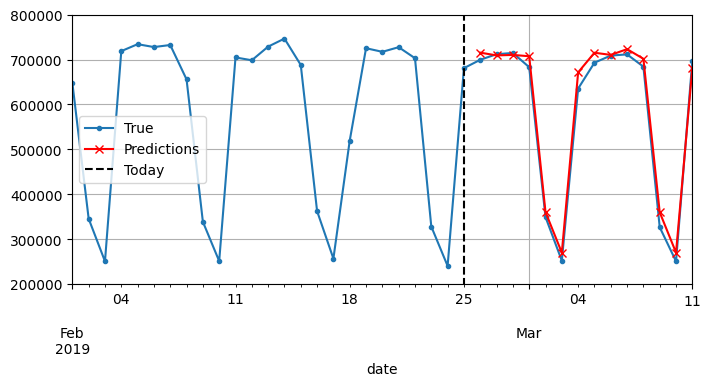

In [254]:
# Forecasts from 2019-02-26 (the 57th day of 2019) to 2019-03-11 (14 days in total)
Y_pred = pd.Series(X[0, -14:, 0], index=pd.date_range("2019-02-26", "2019-03-11"))

fig, ax = plt.subplots(figsize=(8, 3.5))
(rail_valid * 1e6)["2019-02-01":"2019-03-11"].plot(label="True", marker=".", ax=ax)
(Y_pred * 1e6).plot(label="Predictions", grid=True, marker="x", color="r", ax=ax)
ax.vlines("2019-02-25", 0, 1e6, color="k", linestyle="--", label="Today")
ax.set_ylim([200_000, 800_000])
plt.legend(loc="center left")

plt.show()

Notice that if the model makes an error at one time step, then the forecasts for the following time
steps are impacted as well, so the **errors tend to accumulate**. So, it’s preferable to use this
technique only for a small number of steps.

The second option is the **direct multi-step forecasting**: we can still use a sequence-to-vector model, but we train the RNN to predict the next N values in one shot:

<img src="./images/direct-multisteps-prediction.png" width="400">

However, we first **need to change the dataset in order to have targets as vectors** containing the next N values. To do this, we can use again timeseries_dataset_from_array(), but this time asking it to create datasets with longer sequences (seq_length + N) and without targets (targets=None). Then we can use map() method to apply a custom function to each batch of sequences, splitting them into inputs (seq_length) and targets (N).

In [264]:
N = 14 

def split_inputs_and_targets(mulvar_series, ahead=14, target_col=1):
    return mulvar_series[:, :-ahead], mulvar_series[:, -ahead:, target_col]

ahead_train_ds = tf.keras.utils.timeseries_dataset_from_array(
    mulvar_train.to_numpy(),
    targets=None,
    sequence_length=seq_length + 14,
    batch_size=32,
    shuffle=True,
).map(split_inputs_and_targets)

ahead_valid_ds = tf.keras.utils.timeseries_dataset_from_array(
    mulvar_valid.to_numpy(),
    targets=None,
    sequence_length=seq_length + 14,
    batch_size=32
).map(split_inputs_and_targets)


Now we just need the output layer to have N units instead of 1:

In [271]:
ahead_model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, input_shape=[None, 2]),
    tf.keras.layers.Dense(14)
])

In [273]:
opt = tf.keras.optimizers.SGD(learning_rate=0.02, momentum=0.9)
ahead_model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])

In [274]:
history = ahead_model.fit(ahead_train_ds, validation_data=ahead_valid_ds, epochs=500, callbacks=[early_stopping_cb])

Epoch 1/500


33/33 [==============================] - 1s 13ms/step - loss: 0.0628 - mae: 0.2620 - val_loss: 0.0236 - val_mae: 0.1694


2023-07-10 13:51:46.505127: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype double and shape [151,2]
	 [[{{node Placeholder/_0}}]]
2023-07-10 13:51:46.505515: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_13' with dtype int32
	 [[{{node Placeholder/_13}}]]


Epoch 2/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0193 - mae: 0.1656 - val_loss: 0.0177 - val_mae: 0.1474
Epoch 3/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0171 - mae: 0.1563 - val_loss: 0.0162 - val_mae: 0.1426
Epoch 4/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0159 - mae: 0.1504 - val_loss: 0.0152 - val_mae: 0.1335
Epoch 5/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0148 - mae: 0.1440 - val_loss: 0.0136 - val_mae: 0.1299
Epoch 6/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0137 - mae: 0.1375 - val_loss: 0.0124 - val_mae: 0.1252
Epoch 7/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0127 - mae: 0.1311 - val_loss: 0.0113 - val_mae: 0.1172
Epoch 8/500
33/33 [==============================] - 0s 7ms/step - loss: 0.0117 - mae: 0.1248 - val_loss: 0.0103 - val_mae: 0.1114
Epoch 9/500
33/33 [==============================] - 0s 8ms/step - loss: 0.0108 - m

In [276]:
valid_loss, valid_mae = ahead_model.evaluate(ahead_valid_ds)
print("Validantion MAE: ", valid_mae * 1e6)

3/3 [==============================] - 0s 3ms/step - loss: 0.0012 - mae: 0.0317
Validantion MAE:  31744.718551635742


After training this model, we can predict the next N values at once:

In [279]:
X = mulvar_valid.to_numpy()[np.newaxis, :seq_length]  # shape [1, 56, 5]
Y_pred = ahead_model.predict(X)  # shape [1, 14]

print(Y_pred)

1/1 [==============================] - 0s 19ms/step
[[0.70980793 0.7296526  0.7361691  0.68608063 0.389592   0.3071083
  0.6583105  0.7080724  0.72561973 0.70070535 0.697616   0.3654149
  0.29267445 0.67664796]]


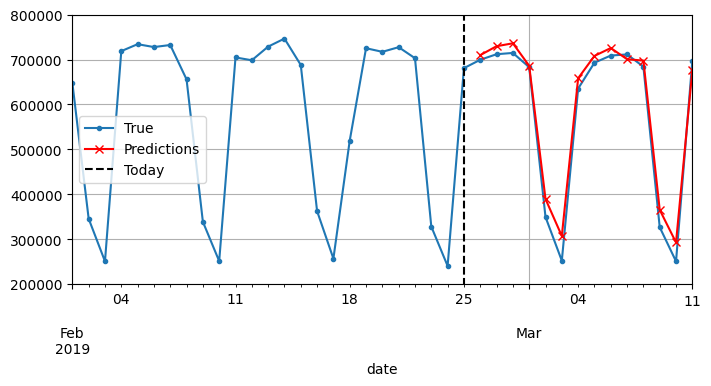

In [280]:
Y_pred = pd.Series(Y_pred[0], index=pd.date_range("2019-02-26", "2019-03-11"))
fig, ax = plt.subplots(figsize=(8, 3.5))
(mulvar_valid.rail * 1e6)["2019-02-01":"2019-03-11"].plot(label="True", marker=".", ax=ax)
(Y_pred * 1e6).plot(label="Predictions", grid=True, marker="x", color="r", ax=ax)
ax.vlines("2019-02-25", 0, 1e6, color="k", linestyle="--", label="Today")
ax.set_ylim([200_000, 800_000])
plt.legend(loc="center left")

plt.show()

The forecasts of this approach for the next day are obviously better than its forecasts for N days into the future, but it doesn’t accumulate errors like the previous one.

The third option is **using a sequence-to-sequence model**: instead of training the model to forecast the next N values only at the very last time step, we can train it to forecast the next N values at each and every time step. 

<img src="./images/sequence-multisteps-prediction.png" width="300">

The advantage of this technique is that the loss will contain a term for the output of the RNN at each and every time step, not just for the output at the last time step. This means there will be many more error gradients flowing through the model, and they won’t have to flow through time as much since they will come from the output of each time step, not just the last one. This will both stabilize and speed up training.

To be clear, at time step 0 the model will output a vector containing the forecasts for time steps 1 to N, then at time step 1 the model will forecast time steps 2 to N+1, and so on. In other words, the targets are sequences of consecutive windows, shifted by one time step at each time step. The target
is not a vector anymore, but a sequence of the same length as the inputs, containing a N-dimensional vector at each step.

Preparing the datasets is not trivial, since each instance has a window as input and a sequence of windows as output. A way to get the result is to use the window() method that returns a dataset of window datasets:

In [281]:
data = tf.data.Dataset.range(7)

dummy_dataset = data.window(3, shift=1)

for window in dummy_dataset:
    for element in window:
        print(f"{element}", end=" ")
    print()

0 1 2 
1 2 3 
2 3 4 
3 4 5 
4 5 6 
5 6 
6 


2023-07-10 14:03:50.360099: W tensorflow/core/framework/dataset.cc:807] Input of Window will not be optimized because the dataset does not implement the AsGraphDefInternal() method needed to apply optimizations.
2023-07-10 14:03:50.360322: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype variant
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:03:50.363667: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype variant
	 [[{{node Placeholder/_0}}]]
2023-07-10 14:03:50.366503: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting 

In the example, the dataset contains six windows, each shifted by one step compared to the previous one, and the last three windows are smaller because they’ve reached the end of the series. In general, we to get rid of these smaller windows by passing drop_remainder=True to the method.

However, window() returns a nested dataset (a list of lists), useful when we want to transform each window by calling its methods, but we cannot use it directly for training: our model expects tensors as not datasets. Therefore, we can use flat_map() method, which converts a nested dataset into a flat one:

In [282]:
dummy_dataset = data.window(3, shift=1, drop_remainder=True)
dummy_dataset = dummy_dataset.flat_map(lambda window: window.batch(3))
list(dummy_dataset)

[<tf.Tensor: shape=(3,), dtype=int64, numpy=array([0, 1, 2])>,
 <tf.Tensor: shape=(3,), dtype=int64, numpy=array([1, 2, 3])>,
 <tf.Tensor: shape=(3,), dtype=int64, numpy=array([2, 3, 4])>,
 <tf.Tensor: shape=(3,), dtype=int64, numpy=array([3, 4, 5])>,
 <tf.Tensor: shape=(3,), dtype=int64, numpy=array([4, 5, 6])>]

We now have a dataset containing consecutive windows represented as tensors. We can repeat the same procedure to get windows of consecutive windows:

In [283]:
dummy_dataset = dummy_dataset.window(4, shift=1, drop_remainder=True)
dummy_dataset = dummy_dataset.flat_map(lambda window: window.batch(4))
list(dummy_dataset)

[<tf.Tensor: shape=(4, 3), dtype=int64, numpy=
 array([[0, 1, 2],
        [1, 2, 3],
        [2, 3, 4],
        [3, 4, 5]])>,
 <tf.Tensor: shape=(4, 3), dtype=int64, numpy=
 array([[1, 2, 3],
        [2, 3, 4],
        [3, 4, 5],
        [4, 5, 6]])>]

Finally, we can use the map() method to split these windows of windows intocinputs and targets:

In [284]:
dummy_dataset = dummy_dataset.map(lambda S: (S[:, 0], S[:, 1:]))
list(dummy_dataset)

[(<tf.Tensor: shape=(4,), dtype=int64, numpy=array([0, 1, 2, 3])>,
  <tf.Tensor: shape=(4, 2), dtype=int64, numpy=
  array([[1, 2],
         [2, 3],
         [3, 4],
         [4, 5]])>),
 (<tf.Tensor: shape=(4,), dtype=int64, numpy=array([1, 2, 3, 4])>,
  <tf.Tensor: shape=(4, 2), dtype=int64, numpy=
  array([[2, 3],
         [3, 4],
         [4, 5],
         [5, 6]])>)]

Now the dataset contains sequences of length 4 as inputs, and the targets are sequences containing the next two steps, for each time step. For example, the first input sequence is [0, 1, 2, 3] has a corresponding target as [[1, 2], [2, 3], [3, 4], [4, 5]], which are the next two values for each time step.

Now we can create an utility function to prepare the datasets for sequence-to-sequence models:

In [285]:
def to_seq2seq_dataset(series, seq_length=56, ahead=14, target_col=1, batch_size=32):
    ds = tf.data.Dataset.from_tensor_slices(series)
    ds = ds.window(ahead + 1, shift=1, drop_remainder=True)
    ds = ds.flat_map(lambda window: window.batch(ahead + 1))
    ds = ds.window(seq_length, shift=1, drop_remainder=True)
    ds = ds.flat_map(lambda window: window.batch(seq_length))
    ds = ds.map(lambda S: (S[:, 0], S[:, 1:, 1]))
    return ds.batch(batch_size)

Now we can create the datasets for our running example:

In [286]:
seq2seq_train = to_seq2seq_dataset(mulvar_train)
seq2seq_valid = to_seq2seq_dataset(mulvar_valid)

And lastly, we can build the sequence-to-sequence model

In [298]:
seq2seq_model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, return_sequences=True, input_shape=[None, 2]),
    tf.keras.layers.Dense(14)
])

It is almost identical to previous model: the only difference is that we set return_sequences=True in the RNN layer. This way, it will output a sequence of vectors, instead of outputting a single vector at the last time step:

In [299]:
opt = tf.keras.optimizers.SGD(learning_rate=0.02, momentum=0.9)
seq2seq_model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])

In [316]:
history = seq2seq_model.fit(seq2seq_train, validation_data=seq2seq_valid, epochs=500, callbacks=[early_stopping_cb])

Epoch 1/1000
      1/Unknown - 0s 17ms/step - loss: 0.0021 - mae: 0.0440

33/33 [==============================] - 0s 13ms/step - loss: 0.0037 - mae: 0.0526 - val_loss: 0.0039 - val_mae: 0.0485
Epoch 2/1000
33/33 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0526 - val_loss: 0.0039 - val_mae: 0.0485
Epoch 3/1000
33/33 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0526 - val_loss: 0.0039 - val_mae: 0.0485
Epoch 4/1000
33/33 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0526 - val_loss: 0.0039 - val_mae: 0.0485
Epoch 5/1000
33/33 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0526 - val_loss: 0.0039 - val_mae: 0.0485
Epoch 6/1000
33/33 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0526 - val_loss: 0.0039 - val_mae: 0.0485
Epoch 7/1000
33/33 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 0.0526 - val_loss: 0.0039 - val_mae: 0.0485
Epoch 8/1000
33/33 [==============================] - 0s 9ms/step - loss: 0.0037 - mae: 

We can evaluate the model forecasts MAE for each steps:

In [317]:
Y_pred_valid = seq2seq_model.predict(seq2seq_valid)
for ahead in range(14):
    preds = pd.Series(Y_pred_valid[:-1, -1, ahead], index=mulvar_valid.index[56 + ahead : -14 + ahead])
    mae = (preds - mulvar_valid["rail"]).abs().mean() * 1e6
    print(f"MAE for +{ahead + 1}: {mae:,.0f}")

3/3 [==============================] - 0s 19ms/step
MAE for +1: 25,418
MAE for +2: 28,053
MAE for +3: 29,681
MAE for +4: 33,068
MAE for +5: 33,684
MAE for +6: 33,115
MAE for +7: 33,976
MAE for +8: 31,357
MAE for +9: 31,070
MAE for +10: 31,363
MAE for +11: 37,903
MAE for +12: 35,931
MAE for +13: 37,171
MAE for +14: 32,831


In [319]:
X = mulvar_valid.to_numpy()[np.newaxis, :seq_length]  # shape [1, 56, 5]
Y_pred = seq2seq_model.predict(X)[0, -1]  # shape [1, 14]

1/1 [==============================] - 0s 19ms/step


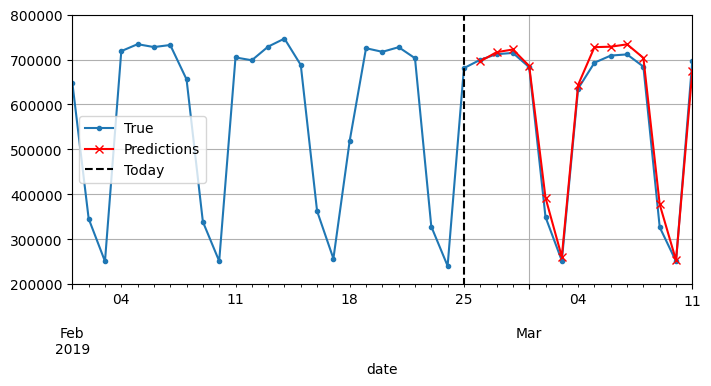

In [320]:
Y_pred = pd.Series(Y_pred, index=pd.date_range("2019-02-26", "2019-03-11"))
fig, ax = plt.subplots(figsize=(8, 3.5))
(mulvar_valid.rail * 1e6)["2019-02-01":"2019-03-11"].plot(label="True", marker=".", ax=ax)
(Y_pred * 1e6).plot(label="Predictions", grid=True, marker="x", color="r", ax=ax)
ax.vlines("2019-02-25", 0, 1e6, color="k", linestyle="--", label="Today")
ax.set_ylim([200_000, 800_000])
plt.legend(loc="center left")

plt.show()

We can combine different approaches to forecasting multiple steps ahead. For example, we can train a model that forecasts N days ahead, then take its output and append it to the inputs, then run the model again to get forecasts for the following N days, and possibly repeat the process. However, simple RNNs can be quite good at forecasting short time series, but they do not perform as well on long time series.

## Unstable Gradients Problem

On long sequences, we must run the network over many time steps, **making the unrolled RNN a very deep network**. Like any deep neural network, it may suffer from the unstable gradients problem: it may take forever to train, or training may be unstable. Many of the tricks used in deep nets can also be used for RNNs: good parameter initialization, faster optimizers, dropout, and so on. 

However, **non-saturating activation functions (e.g., ReLU) may not help**. Suppose that gradient descent updates the weights in a way that increases the outputs slightly at the first time step. Because the same weights are used at every time step, the outputs at the second time step may also be slightly increased, and those at the third, and so on until the outputs explode, and a nonsaturating activation function does not prevent that. We can reduce this risk by using a smaller learning rate or we can use a saturating activation function (e.g. hyperbolic tangent). In the same way, gradients can explode. If we notice that training is unstable, we should monitor the size of the gradients and perhaps use gradient clipping.

Moreover, **batch normalization cannot be used as efficiently with RNNs**. We cannot use it between time steps, only between recurrent layers. To be more precise, it is technically possible to add a batch normalization layer to a memory cell, so that it will be applied at each time step. However, the same batch normalizatoin layer will be used at each time step, with the same parameters, regardless of the actual scale and offset of the inputs and hidden state. In practice, this does not yield good results: as demonstrated in [Batch Normalized Recurrent Neural Networks](https://arxiv.org/abs/1510.01378). It was slightly better than nothing when applied between recurrent layers, but not within recurrent layers.

[**Layer normalization**](https://arxiv.org/abs/1607.06450) often works better with RNNs: it is similar to batch normalization, but instead of normalizing across the batch dimension, it normalizes across the features dimension. One advantage is that it can compute the required statistics on the fly, at each time step, independently for each instance. This also means that it behaves the same way during training and testing, and it does not need to use exponential moving averages to estimate the feature statistics across all instances in the training set. In an RNN, it is typically used right after the linear combination of the inputs and the hidden states.

We need to define a custom memory cell, which is just like a regular layer, except it will apply layer
normalization at each time step, and its call() method takes two arguments: the inputs at the current time step and the hidden states from the previous time step.

In [328]:
class LNSimpleRNNCell(tf.keras.layers.Layer):
    def __init__(self, units, activation="tanh", **kwargs):
        super().__init__(**kwargs)
        self.state_size = units
        self.output_size = units

        # create a SimpleRNNCell with no activation function (because we
        # want to perform layer normalization after the linear operation but
        # before the activation function)
        self.simple_rnn_cell = tf.keras.layers.SimpleRNNCell(units, activation=None)
        self.layer_norm = tf.keras.layers.LayerNormalization()
        self.activation = tf.keras.activations.get(activation)

    def call(self, inputs, states):
        outputs, new_states = self.simple_rnn_cell(inputs, states)
        norm_outputs = self.activation(self.layer_norm(outputs))
        return norm_outputs, [norm_outputs]

Notice that the states argument is a list containing one or more tensors. In a simple RNN cell it contains a single tensor equal to the outputs of the previous time step, but other cells may have multiple state tensors. A cell must also have a state_size attribute and an output_size attribute. In a simple RNN, both are simply equal to the number of units. 

In [334]:
custom_ln_model = tf.keras.Sequential([
    tf.keras.layers.RNN(LNSimpleRNNCell(32), return_sequences=True, input_shape=[None, 2]),
    tf.keras.layers.Dense(14)
])

In [335]:
opt = tf.keras.optimizers.SGD(learning_rate=0.02, momentum=0.9)
custom_ln_model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])

Just training for some epochs to show that it works:

In [336]:
history = custom_ln_model.fit(seq2seq_train, validation_data=seq2seq_valid, epochs=500, callbacks=[early_stopping_cb])

Epoch 1/5


33/33 [==============================] - 2s 25ms/step - loss: 0.1348 - mae: 0.3695 - val_loss: 0.0309 - val_mae: 0.1758
Epoch 2/5
33/33 [==============================] - 1s 17ms/step - loss: 0.0214 - mae: 0.1760 - val_loss: 0.0219 - val_mae: 0.1611
Epoch 3/5
33/33 [==============================] - 1s 17ms/step - loss: 0.0192 - mae: 0.1661 - val_loss: 0.0201 - val_mae: 0.1625
Epoch 4/5
33/33 [==============================] - 1s 17ms/step - loss: 0.0183 - mae: 0.1644 - val_loss: 0.0194 - val_mae: 0.1598
Epoch 5/5
33/33 [==============================] - 1s 16ms/step - loss: 0.0177 - mae: 0.1626 - val_loss: 0.0189 - val_mae: 0.1579


In [337]:
Y_pred_valid = custom_ln_model.predict(seq2seq_valid)
for ahead in range(14):
    preds = pd.Series(Y_pred_valid[:-1, -1, ahead], index=mulvar_valid.index[56 + ahead : -14 + ahead])
    mae = (preds - mulvar_valid["rail"]).abs().mean() * 1e6
    print(f"MAE for +{ahead + 1}: {mae:,.0f}")

3/3 [==============================] - 0s 14ms/step
MAE for +1: 136,748
MAE for +2: 162,667
MAE for +3: 145,744
MAE for +4: 157,006
MAE for +5: 151,718
MAE for +6: 145,106
MAE for +7: 151,408
MAE for +8: 133,953
MAE for +9: 161,726
MAE for +10: 161,509
MAE for +11: 154,425
MAE for +12: 158,581
MAE for +13: 166,979
MAE for +14: 130,431


Similarly, we can create a custom cell to apply dropout between each time step. However, most recurrent layers in Keras have dropout hyperparameters. With these techniques, we can alleviate the unstable gradients problem and train an RNN much more efficiently. 

## Short-Term Memory Problem

One of the appeals of RNNs is the idea that they might be able to connect previous information to the present task, such as using previous video frames might inform the understanding of the present frame. Sometimes, we only need to look at recent information to perform the present task. For example, consider a language model trying to predict the next word based on the previous ones. If we are trying to predict the last word in "the clouds are in the" we don’t need any further context, it’s pretty obvious the next word is going to be "sky". In such cases, where the gap between the relevant information and the place that it’s needed is small, RNNs can learn to use the past information. But there are also cases where we need **more context**. Consider trying to predict the last word in the text "I grew up in France... I speak fluent". Recent information suggests that the next word is probably the name of a language, but if we want to narrow down which language, we need the context of France, from further back. It’s entirely possible for the gap between the relevant information and the point where it is needed to become very large. Unfortunately, as that gap grows, [RNNs become unable to learn to connect the information](https://ieeexplore.ieee.org/document/279181).

Due to the transformations that the data goes through when traversing an RNN, some information is lost at each time step. After a while, the RNN’s state contains virtually no trace of the first inputs. To tackle this problem, various types of cells with **long-term memory** have been introduced. They proven so successful that the basic cells are not used anymore. 

The [**long short-term memory (LSTM)** cell](https://ieeexplore.ieee.org/abstract/document/6795963) looks exactly like a regular cell from the input-outpurt point of view (), however its state is split into two vectors: $h_t$ (the short-term state) and $c_t$ (the long-term state). The key idea is that **the network can learn what to store in the long-term state, what to throw away, and what to read from it**.

The long-term cell state $c_t$ is like a conveyor belt: it runs straight down the entire chain, with only some minor linear interactions. It’s very easy for information to just flow along it unchanged:

<img src="./images/lstm_1.png" width="400">

The LSTM cell has the ability to remove or add information to the long-term state, carefully regulated by structures called gates. They are composed of a sigmoid neural net layer and a pointwise multiplication operation. The sigmoid layer outputs numbers between zero and one, describing how much of each component should be let through. An LSTM cell has three of these gates, to protect and control the cell long-term state.

The first step is to decide what information we’re going to throw away from the long-term cell state. This decision is made by a sigmoid layer called **the forget gate layer**:

<img src="./images/lstm_2.png" width="400">

$\displaystyle f_t=\sigma(W_f\cdot [h_{t-1},x_t]+b_f)$

In the language model exampe, the cell log-term state might include the gender of the present subject, so that the correct pronouns can be used. When we see a new subject, we want to forget the gender of the old subject.

The next step is to decide what new information we’re going to store in the cell long-term state:

<img src="./images/lstm_3.png" width="430">

$\displaystyle i_t=\sigma(W_i\cdot [h_{t-1},x_t]+b_i)$

$\displaystyle \hat{c}_t=\tanh(W_c\cdot [h_{t-1},x_t]+b_c)$

This has two parts. First, a sigmoid layer called the **input gate layer** decides which values we’ll update. Next, a tanh layer creates a vector of new candidate values $\hat{c}_t$, that could be added to the state. In the next step, we’ll combine these two to create an update to the state. In the example, we want to add the gender of the new subject to the cell state, to replace the old one we are forgetting.

It’s now time to update the old long-term state $C_{t−1}$ into the new long-term state $C_t$. The previous steps already decided what to do, we just need to actually do it:

<img src="./images/lstm_4.png" width="430">

$\displaystyle c_t=f_t\ast C_{t-1}+i_t \ast \hat{c}_t$

We multiply the old state by $f_t$ (forgetting things we decided to forget earlier), then we add $\hat{c}_t$ (the new candidate values), scaled by how much we decided to update each state value. In the example, this is where we actually drop the information about the old subject gender and add the new information.

Finally, we need to decide what we’re going to output using the **output gate**. This output will be based on our long-term state, but will be a filtered version. First, we run a sigmoid layer which decides what parts of the long-term state we’re going to output. Then, we put the long-term state through tanh (to push the values to be between −1  and 1) and multiply it by the output of the sigmoid gate, so that we only output the parts we decided to:

<img src="./images/lstm_5.png" width="430">

$\displaystyle o_t=\sigma(W_o\cdot [h_{t-1},x_t]+b_o)$

$\displaystyle h_t= o_t \ast \tanh(c_t)$

In the example, since it just saw a subject, it might want to output information relevant to a verb, in case that’s what is coming next. For example, it might output whether the subject is singular or plural, so that we know what form a verb should be conjugated into if that’s what follows next. In short, an LSTM cell can learn to recognize an important input (that’s the role of the input gate), store it in the long-term state, preserve it for as long as it is needed (that’s the role of the forget gate), and extract it whenever it is needed.

In Keras, we can simply use the LSTM layer instead of the SimpleRNN layer:

In [341]:
lstm_model = tf.keras.models.Sequential([
    tf.keras.layers.LSTM(32, return_sequences=True, input_shape=[None, 2]),
    tf.keras.layers.Dense(14)
])

2023-07-11 13:02:30.223789: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2023-07-11 13:02:30.225114: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2023-07-11 13:02:30.226109: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

In [342]:
opt = tf.keras.optimizers.SGD(learning_rate=0.02, momentum=0.9)
lstm_model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])

Just training for 5 epochs to show that it works:

In [345]:
history = lstm_model.fit(seq2seq_train, validation_data=seq2seq_valid, epochs=5, callbacks=[early_stopping_cb])

Epoch 1/5


33/33 [==============================] - 1s 15ms/step - loss: 0.0076 - mae: 0.0957 - val_loss: 0.0091 - val_mae: 0.1037
Epoch 2/5
33/33 [==============================] - 0s 14ms/step - loss: 0.0076 - mae: 0.0956 - val_loss: 0.0091 - val_mae: 0.1037
Epoch 3/5
33/33 [==============================] - 0s 14ms/step - loss: 0.0076 - mae: 0.0956 - val_loss: 0.0091 - val_mae: 0.1037
Epoch 4/5
33/33 [==============================] - 0s 14ms/step - loss: 0.0076 - mae: 0.0956 - val_loss: 0.0091 - val_mae: 0.1036
Epoch 5/5
33/33 [==============================] - 0s 14ms/step - loss: 0.0076 - mae: 0.0955 - val_loss: 0.0090 - val_mae: 0.1036


There are several variants of the LSTM cell. One particularly popular variant is the [**Gated Recurrent Unit (GRU) cell**](https://arxiv.org/abs/1406.1078). It is a simplified version of the LSTM cell, and it seems to perform just as well⁠:

<img src="./images/gru.png" width="430">

$\displaystyle z_t=\sigma(W_z\cdot [h_{t-1},x_t])$

$\displaystyle r_t=\sigma(W_r \cdot [h_{t-1},x_t])$

$\displaystyle \hat{h}_t = \tanh(W \cdot [r_t \ast h_{t-1},x_t])$

$\displaystyle h_t = (1-z_t) \ast h_{t-1} + z_t \ast  \hat{h}_t$

Both state vectors are merged into a single vector $h_t$. A single gate controller $z$ controls both the forget gate and the input gate. If the gate controller outputs a 1, the forget gate is open (1) and the input gate is closed (0). If it outputs a 0, the opposite happens. In other words, whenever a memory must be stored, the location where it will be stored is erased first. There is no output gate: the full state vector is output at every time step. However, there is a new gate controller $r$ that controls which part of the previous state will be shown to the main layer.

Keras provides a tf.keras.layers.GRU layer: using it is just a matter of replacing SimpleRNN or LSTM with GRU. It also provides a tf.keras.layers.GRUCell, in case you want to create a custom cell based on a GRU cell.

In [349]:
gru_model = tf.keras.Sequential([
    tf.keras.layers.GRU(32, return_sequences=True, input_shape=[None, 2]),
    tf.keras.layers.Dense(14)
])

2023-07-11 13:38:03.533281: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2023-07-11 13:38:03.534440: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2023-07-11 13:38:03.535775: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

In [350]:
opt = tf.keras.optimizers.SGD(learning_rate=0.02, momentum=0.9)
gru_model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])

Just training for 5 epochs to show that it works:

In [351]:
history = gru_model.fit(seq2seq_train, validation_data=seq2seq_valid, epochs=5, callbacks=[early_stopping_cb])

Epoch 1/5


2023-07-11 13:38:06.653890: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2023-07-11 13:38:06.655169: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2023-07-11 13:38:06.656521: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

     33/Unknown - 2s 14ms/step - loss: 0.1065 - mae: 0.3859

2023-07-11 13:38:08.810716: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2023-07-11 13:38:08.812765: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2023-07-11 13:38:08.813972: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

33/33 [==============================] - 3s 27ms/step - loss: 0.1065 - mae: 0.3859 - val_loss: 0.0226 - val_mae: 0.1683
Epoch 2/5
33/33 [==============================] - 1s 16ms/step - loss: 0.0187 - mae: 0.1533 - val_loss: 0.0191 - val_mae: 0.1520
Epoch 3/5
33/33 [==============================] - 1s 15ms/step - loss: 0.0172 - mae: 0.1594 - val_loss: 0.0186 - val_mae: 0.1534
Epoch 4/5
33/33 [==============================] - 1s 15ms/step - loss: 0.0171 - mae: 0.1585 - val_loss: 0.0185 - val_mae: 0.1525
Epoch 5/5
33/33 [==============================] - 1s 15ms/step - loss: 0.0170 - mae: 0.1580 - val_loss: 0.0184 - val_mae: 0.1520


These are only two of [the most notable LSTM variants](https://arxiv.org/pdf/1503.04069.pdf).

LSTM and GRU cells still have a **fairly limited short-term memory**, and they have a hard time learning long-term patterns in sequences of 100 time steps or more (such as audio samples, long time series, or long sentences). One way to solve this is to shorten the input sequences, for example, using **1D
convolutional layers**.

Similarly two 2D convolutional, a 1D convolutional layer slides several kernels across a sequence, producing a 1D feature map per kernel. Each kernel will learn to detect a single very short sequential pattern (no longer than the kernel size).

<img src="./images/1d_convolution.png" width="430">

This means that we can build a neural network composed of a mix of recurrent layers and 1D convolutional layers (or even 1D pooling layers). By shortening the sequences the convolutional layer may help the LSTM/GRU layers detect longer patterns.

For example, the following model is the same as earlier, except it starts with a 1D convolutional layer that **downsamples the input sequence** by a factor of 2 (using a stride of 2). The kernel size is larger than the stride, so all inputs will be used to compute the layer’s output, and therefore the model can learn to preserve the useful information, dropping only the unimportant details.

In [355]:
conv_rnn_model = tf.keras.Sequential([
    tf.keras.layers.Conv1D(filters=32, kernel_size=4, strides=2, activation="relu", input_shape=[None, 2]),
    tf.keras.layers.GRU(32, return_sequences=True),
    tf.keras.layers.Dense(14)
])

2023-07-11 13:49:54.521924: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2023-07-11 13:49:54.523413: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2023-07-11 13:49:54.524512: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus


Notice that we must also crop off the first three time steps in the targets: indeed, the kernel’s size is 4, so the first output of the convolutional layer will be based on the input time steps 0 to 3, and the first forecasts will be for time steps 4 to 17 (instead of time steps 1 to 14). Moreover, we must downsample the targets by a factor of 2, because of the stride:

In [354]:
longer_train = to_seq2seq_dataset(mulvar_train, seq_length=112)
longer_valid = to_seq2seq_dataset(mulvar_valid, seq_length=112)

downsampled_train = longer_train.map(lambda X, Y: (X, Y[:, 3::2]))
downsampled_valid = longer_valid.map(lambda X, Y: (X, Y[:, 3::2]))

Just training for 5 epochs to show that it works:

In [356]:
opt = tf.keras.optimizers.SGD(learning_rate=0.02, momentum=0.9)
conv_rnn_model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])

In [357]:
history = conv_rnn_model.fit(downsampled_train, validation_data=downsampled_valid, epochs=5, callbacks=[early_stopping_cb])

Epoch 1/5


2023-07-11 13:50:16.688627: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype double and shape [1096,2]
	 [[{{node Placeholder/_0}}]]
2023-07-11 13:50:16.688967: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype double and shape [1096,2]
	 [[{{node Placeholder/_0}}]]
2023-07-11 13:50:16.935736: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_d

     29/Unknown - 2s 15ms/step - loss: 0.1116 - mae: 0.4002

2023-07-11 13:50:19.066413: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype double and shape [151,2]
	 [[{{node Placeholder/_0}}]]
2023-07-11 13:50:19.066746: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype double and shape [151,2]
	 [[{{node Placeholder/_0}}]]
2023-07-11 13:50:19.293512: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim

31/31 [==============================] - 3s 31ms/step - loss: 0.1076 - mae: 0.3904 - val_loss: 0.0214 - val_mae: 0.1614
Epoch 2/5
31/31 [==============================] - 1s 17ms/step - loss: 0.0184 - mae: 0.1495 - val_loss: 0.0181 - val_mae: 0.1595
Epoch 3/5
31/31 [==============================] - 1s 17ms/step - loss: 0.0166 - mae: 0.1582 - val_loss: 0.0181 - val_mae: 0.1553
Epoch 4/5
31/31 [==============================] - 1s 17ms/step - loss: 0.0164 - mae: 0.1554 - val_loss: 0.0179 - val_mae: 0.1551
Epoch 5/5
31/31 [==============================] - 1s 19ms/step - loss: 0.0163 - mae: 0.1551 - val_loss: 0.0178 - val_mae: 0.1546


If we train and evaluate this model, we will find that it outperforms the previous model (by a small margin). In fact, it is actually possible to use only 1D convolutional layers and drop the recurrent layers entirely! This is the [**WaveNet architecuture**](https://arxiv.org/abs/1609.03499). It stacked 1D convolutional layers, doubling the dilation rate (how spread apart each neuron’s inputs are) at every layer: the first convolutional layer gets a glimpse of just two time steps at a time, while the next one sees four time steps (its receptive field is four time steps long), the next one sees eight time steps, and so on.

<img src="./images/wavenetwork.png" width="600">

This way, the lower layers learn short-term patterns, while the higher layers learn long-term patterns. Thanks to the doubling dilation rate, the network can process extremely large sequences very efficiently. The architecute also left-pads the input sequences with a number of zeros equal to the dilation rate before every layer, to preserve the same sequence length throughout the network.

Here is how to implement a simplified WaveNet to tackle the same sequences as earlier:

In [361]:
wavenet_model = tf.keras.Sequential()

# the model starts with an explicit input layer
wavenet_model.add(tf.keras.layers.InputLayer(input_shape=[None, 2]))

# then it continues with 1D convolutional layers using 
# growing dilation rates: 1, 2, 4, 8, two times
# Thanks to the causal padding, every convolutional layer outputs a sequence of the
# ame length as its input sequence, so the targets we use during training can
# be the full sequences: no need to crop them or downsample them.

for rate in (1, 2, 4, 8) * 2:
    wavenet_model.add(tf.keras.layers.Conv1D(filters=32, kernel_size=2, padding="causal", 
                                             activation="relu", dilation_rate=rate))

# finally, we add the output layer: a convolutional layer with 14 filters of size 1 and 
# without any activation function. 
wavenet_model.add(tf.keras.layers.Conv1D(filters=14, kernel_size=1))

Just training for 5 epochs to show that it works:

In [363]:
opt = tf.keras.optimizers.SGD(learning_rate=0.02, momentum=0.9)
wavenet_model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])

In [364]:
history = wavenet_model.fit(longer_train, validation_data=longer_valid, epochs=5, callbacks=[early_stopping_cb])

Epoch 1/5


2023-07-11 14:08:41.717659: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype double and shape [1096,2]
	 [[{{node Placeholder/_0}}]]
2023-07-11 14:08:41.717984: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype double and shape [1096,2]
	 [[{{node Placeholder/_0}}]]


     31/Unknown - 2s 15ms/step - loss: 0.1528 - mae: 0.5097

2023-07-11 14:08:43.627238: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype double and shape [151,2]
	 [[{{node Placeholder/_0}}]]
2023-07-11 14:08:43.627628: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype double and shape [151,2]
	 [[{{node Placeholder/_0}}]]


31/31 [==============================] - 2s 31ms/step - loss: 0.1528 - mae: 0.5097 - val_loss: 0.0578 - val_mae: 0.2978
Epoch 2/5
31/31 [==============================] - 1s 18ms/step - loss: 0.0391 - mae: 0.2358 - val_loss: 0.0213 - val_mae: 0.1669
Epoch 3/5
31/31 [==============================] - 1s 18ms/step - loss: 0.0176 - mae: 0.1623 - val_loss: 0.0186 - val_mae: 0.1524
Epoch 4/5
31/31 [==============================] - 1s 18ms/step - loss: 0.0161 - mae: 0.1574 - val_loss: 0.0186 - val_mae: 0.1508
Epoch 5/5
31/31 [==============================] - 1s 22ms/step - loss: 0.0160 - mae: 0.1564 - val_loss: 0.0186 - val_mae: 0.1505


The models discussed offer similar performance for the simple ridership forecasting task, but they may vary significantly depending on the task and the amount of available data.

## Exercise

**1 - Download the [Bach chorales](https://paperswithcode.com/dataset/jsb-chorales) dataset and unzip it. It is composed of 382 chorales composed by Johann Sebastian Bach. Each chorale is 100 to 640 time steps long, and each time step contains 4 integers, where each integer corresponds to a note’s index on a piano (except for the
value 0, which means that no note is played).** 

In [4]:
url = "https://www.dropbox.com/scl/fi/naevqylv41x21zdiol1rq/jsb_chorales.zip?rlkey=zhsumvz5mfmezu1vs59fu0b0h&dl=1"  # dl=1 is important
u = urllib.request.urlopen(url)
data = u.read()
u.close()
with open("./data/jsb_chorales.zip", "wb") as f :
   f.write(data)

In [5]:
import zipfile

with zipfile.ZipFile("./data/jsb_chorales.zip","r") as zip_ref:
    zip_ref.extractall("./data")

In [7]:
from pathlib import Path
jsb_chorales_dir = Path("data/jsb_chorales")

train_files = sorted(jsb_chorales_dir.glob("train/chorale_*.csv"))
valid_files = sorted(jsb_chorales_dir.glob("valid/chorale_*.csv"))
test_files = sorted(jsb_chorales_dir.glob("test/chorale_*.csv"))

In [10]:
def load_chorales(filepaths):
    return [pd.read_csv(filepath).values.tolist() for filepath in filepaths]

train_chorales = load_chorales(train_files)
valid_chorales = load_chorales(valid_files)
test_chorales = load_chorales(test_files)

In [11]:
train_chorales[0]

[[74, 70, 65, 58],
 [74, 70, 65, 58],
 [74, 70, 65, 58],
 [74, 70, 65, 58],
 [75, 70, 58, 55],
 [75, 70, 58, 55],
 [75, 70, 60, 55],
 [75, 70, 60, 55],
 [77, 69, 62, 50],
 [77, 69, 62, 50],
 [77, 69, 62, 50],
 [77, 69, 62, 50],
 [77, 70, 62, 55],
 [77, 70, 62, 55],
 [77, 69, 62, 55],
 [77, 69, 62, 55],
 [75, 67, 63, 48],
 [75, 67, 63, 48],
 [75, 69, 63, 48],
 [75, 69, 63, 48],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [75, 69, 63, 48],
 [75, 69, 63, 48],
 [75, 67, 63, 48],
 [75, 67, 63, 48],
 [77, 65, 62, 50],
 [77, 65, 62, 50],
 [77, 65, 60, 50],
 [77, 65, 60, 50],
 [74, 67, 58, 55],
 [74, 67, 58, 55],
 [74, 67, 58, 53],
 [74, 67, 58, 53],
 [72, 67, 58, 51],
 [72, 67, 58, 51],
 [72, 67, 58, 51],
 [72, 67, 58, 51],
 [72, 65, 57

In [28]:
notes = set()
for chorales in (train_chorales, valid_chorales, test_chorales):
    for chorale in chorales:
        for chord in chorale:
            notes |= set(chord)

n_notes = len(notes)
min_note = min(notes - {0})
max_note = max(notes)

assert min_note == 36
assert max_note == 81

Notice that values range from 36 (C1 = C on octave 1) to 81 (A5 = A on octave 5), plus 0 for silence. Let's write some functions to listen to chorales:

In [12]:
def notes_to_frequencies(notes):
    # Frequency doubles when you go up one octave; there are 12 semi-tones
    # per octave; Note A on octave 4 is 440 Hz, and it is note number 69.
    return 2 ** ((np.array(notes) - 69) / 12) * 440

In [13]:
def frequencies_to_samples(frequencies, tempo, sample_rate):
    note_duration = 60 / tempo # the tempo is measured in beats per minutes
    # To reduce click sound at every beat, we round the frequencies to try to
    # get the samples close to zero at the end of each note.
    frequencies = (note_duration * frequencies).round() / note_duration
    n_samples = int(note_duration * sample_rate)
    time = np.linspace(0, note_duration, n_samples)
    sine_waves = np.sin(2 * np.pi * frequencies.reshape(-1, 1) * time)
    # Removing all notes with frequencies ≤ 9 Hz (includes note 0 = silence)
    sine_waves *= (frequencies > 9.).reshape(-1, 1)
    return sine_waves.reshape(-1)

In [14]:
def chords_to_samples(chords, tempo, sample_rate):
    freqs = notes_to_frequencies(chords)
    freqs = np.r_[freqs, freqs[-1:]] # make last note a bit longer
    merged = np.mean([frequencies_to_samples(melody, tempo, sample_rate)
                     for melody in freqs.T], axis=0)
    n_fade_out_samples = sample_rate * 60 // tempo # fade out last note
    fade_out = np.linspace(1., 0., n_fade_out_samples)**2
    merged[-n_fade_out_samples:] *= fade_out
    return merged

In [18]:

from IPython.display import Audio

def play_chords(chords, tempo=160, amplitude=0.1, sample_rate=44100, filepath=None):
    samples = amplitude * chords_to_samples(chords, tempo, sample_rate)
    if filepath:
        from scipy.io import wavfile
        samples = (2**15 * samples).astype(np.int16)
        wavfile.write(filepath, sample_rate, samples)
        return display(Audio(filepath))
    else:
        return display(Audio(samples, rate=sample_rate))

Now let's listen to a few chorales:

In [19]:
for index in range(3):
    play_chords(train_chorales[index])

**2 - Train a model (recurrent, convolutional, or both) that can predict the next time step (four notes), given a sequence of time steps from a chorale.**

We need to train a model that can predict the next chord given all the previous chords. If we try to predict the next chord in one shot (all 4 notes at once), we gets notes that don't go very well together (believe me, I tried). It's much better (and simpler) to predict one note at a time. So we will need to preprocess every chorale, turning each chord into an arpegio (i.e., a sequence of notes rather than notes played simultaneuously). So each chorale will be a long sequence of notes (rather than chords), and we can just train a model that can predict the next note given all the previous notes.  We will also shift the values so that they range from 0 to 46, where 0 represents silence, and values 1 to 46 represent notes 36 (C1) to 81 (A5). And we will train the model on windows of 128 notes (i.e., 32 chords).

In this simple case, the dataset fits in memory, so we could preprocess the chorales in RAM using any Python code we like, but we will demonstrate here how to do all the preprocessing using tf.data, in order to be able to manage also dataset that dosn't fit in memory.

In [20]:
def create_target(batch):
    X = batch[:, :-1]
    Y = batch[:, 1:] # predict next note in each arpegio, at each step
    return X, Y

In [21]:
def preprocess(window):
    window = tf.where(window == 0, window, window - min_note + 1) # shift values
    return tf.reshape(window, [-1]) # convert to arpegio

In [22]:
def bach_dataset(chorales, batch_size=32, shuffle_buffer_size=None,
                 window_size=32, window_shift=16, cache=True):
    def batch_window(window):
        return window.batch(window_size + 1)

    def to_windows(chorale):
        dataset = tf.data.Dataset.from_tensor_slices(chorale)
        dataset = dataset.window(window_size + 1, window_shift, drop_remainder=True)
        return dataset.flat_map(batch_window)

    chorales = tf.ragged.constant(chorales, ragged_rank=1)
    dataset = tf.data.Dataset.from_tensor_slices(chorales)
    dataset = dataset.flat_map(to_windows).map(preprocess)
    if cache:
        dataset = dataset.cache()
    if shuffle_buffer_size:
        dataset = dataset.shuffle(shuffle_buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.map(create_target)
    return dataset.prefetch(1)

Now let's create the training set, the validation set and the test set:

In [29]:
train_set = bach_dataset(train_chorales, shuffle_buffer_size=1000)
valid_set = bach_dataset(valid_chorales)
test_set = bach_dataset(test_chorales)

We will use a sequence-to-sequence approach, where we feed a window to the neural net, and it tries to predict that same window shifted one time step into the future. We could feed the note values directly to the model, as floats, but this would probably not give good results. The relationships between notes are not that simple: for example, if you replace a C3 with a C4, the melody will still sound fine, even though these notes are 12 semi-tones apart (i.e., one octave). Conversely, if you replace a C3 with a C\#3, it's very likely that the chord will sound horrible, despite these notes being just next to each other. So we will use an Embedding layer to convert each note to a small vector representation (we will see embeddings in another notebook). We will use 5-dimensional embeddings, so the output of this first layer will have a shape of [batch_size, window_size, 5]. We will then feed this data to a small WaveNet-like neural network, composed of a stack of 4 Conv1D layers with doubling dilation rates. We will intersperse these layers with BatchNormalization layers for faster better convergence. Then one LSTM layer to try to capture long-term patterns. And finally a Dense layer to produce the final note probabilities. It will predict one probability for each chorale in the batch, for each time step, and for each possible note (including silence). So the output shape will be [batch_size, window_size, 47].

In [30]:
n_embedding_dims = 5

model = tf.keras.Sequential([
    tf.keras.layers.Embedding(input_dim=n_notes, output_dim=n_embedding_dims,
                           input_shape=[None]),
    tf.keras.layers.Conv1D(32, kernel_size=2, padding="causal", activation="relu"),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(48, kernel_size=2, padding="causal", activation="relu", dilation_rate=2),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(64, kernel_size=2, padding="causal", activation="relu", dilation_rate=4),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(96, kernel_size=2, padding="causal", activation="relu", dilation_rate=8),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.LSTM(256, return_sequences=True),
    tf.keras.layers.Dense(n_notes, activation="softmax")
])

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, None, 5)           235       
                                                                 
 conv1d (Conv1D)             (None, None, 32)          352       
                                                                 
 batch_normalization (BatchN  (None, None, 32)         128       
 ormalization)                                                   
                                                                 
 conv1d_1 (Conv1D)           (None, None, 48)          3120      
                                                                 
 batch_normalization_1 (Batc  (None, None, 48)         192       
 hNormalization)                                                 
                                                                 
 conv1d_2 (Conv1D)           (None, None, 64)          6

2023-07-14 13:00:24.617989: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2023-07-14 13:00:24.619568: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2023-07-14 13:00:24.620629: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

Now we're ready to compile and train the model!

In [31]:
optimizer = tf.keras.optimizers.Nadam(learning_rate=1e-3)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer, metrics=["accuracy"])

In [32]:
model.fit(train_set, epochs=20, validation_data=valid_set)

Epoch 1/20


2023-07-14 13:00:31.782884: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype variant and shape [229]
	 [[{{node Placeholder/_0}}]]
2023-07-14 13:00:31.783675: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype variant and shape [229]
	 [[{{node Placeholder/_0}}]]
2023-07-14 13:00:32.282459: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' 

     98/Unknown - 51s 460ms/step - loss: 1.8791 - accuracy: 0.5281

2023-07-14 13:01:22.455294: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype variant and shape [76]
	 [[{{node Placeholder/_0}}]]
2023-07-14 13:01:22.837103: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2023-07-14 13:01:22.838266: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gr

98/98 [==============================] - 61s 572ms/step - loss: 1.8791 - accuracy: 0.5281 - val_loss: 3.5540 - val_accuracy: 0.0809
Epoch 2/20
98/98 [==============================] - 80s 821ms/step - loss: 0.8585 - accuracy: 0.7732 - val_loss: 3.7054 - val_accuracy: 0.0826
Epoch 3/20
98/98 [==============================] - 62s 631ms/step - loss: 0.7213 - accuracy: 0.7984 - val_loss: 3.5234 - val_accuracy: 0.1417
Epoch 4/20
98/98 [==============================] - 173s 2s/step - loss: 0.6518 - accuracy: 0.8131 - val_loss: 3.0466 - val_accuracy: 0.2125
Epoch 5/20
98/98 [==============================] - 67s 688ms/step - loss: 0.6012 - accuracy: 0.8238 - val_loss: 2.0218 - val_accuracy: 0.4137
Epoch 6/20
98/98 [==============================] - 2073s 21s/step - loss: 0.5624 - accuracy: 0.8325 - val_loss: 0.9131 - val_accuracy: 0.7403
Epoch 7/20
98/98 [==============================] - 62s 634ms/step - loss: 0.5283 - accuracy: 0.8410 - val_loss: 0.6834 - val_accuracy: 0.8016
Epoch 8/20
9

We have not done much hyperparameter search, so feel free to iterate on this model and try to optimize it. For example, we could try removing the LSTM layer and replacing it with Conv1D layers. You could also play with the number of layers, the learning rate, the optimizer, and so on. Once we're satisfied with the performance of the model on the validation set, we can save it and evaluate it one last time on the test set:

In [34]:
model.save("./data/bach_model", save_format="tf")

2023-07-14 13:57:25.172447: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2023-07-14 13:57:25.174101: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2023-07-14 13:57:25.175874: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

INFO:tensorflow:Assets written to: ./data/bach_model/assets


INFO:tensorflow:Assets written to: ./data/bach_model/assets


In [35]:
model.evaluate(test_set)

34/34 [==============================] - 6s 174ms/step - loss: 0.6610 - accuracy: 0.8178


[0.6609758734703064, 0.8177668452262878]

**3 - Use the model to generate Bach-like music, one note at a time: you can do this by giving the model the start of a chorale and asking it to predict the next time step, then appending these time steps to the input sequence and asking the model for the next note, and so on.**

There's no real need for a test set in this exercise, since we will perform the final evaluation by just listening to the music produced by the model. So if we want, you can add the test set to the train set, and train the model again, hopefully getting a slightly better model.

Now let's write a function that will generate a new chorale. We will give it a few seed chords, it will convert them to arpegios (the format expected by the model), and use the model to predict the next note, then the next, and so on. In the end, it will group the notes 4 by 4 to create chords again, and return the resulting chorale.

In [36]:
def generate_chorale(model, seed_chords, length):
    arpegio = preprocess(tf.constant(seed_chords, dtype=tf.int64))
    arpegio = tf.reshape(arpegio, [1, -1])
    for chord in range(length):
        for note in range(4):
            next_note = model.predict(arpegio, verbose=0).argmax(axis=-1)[:1, -1:]
            arpegio = tf.concat([arpegio, next_note], axis=1)
    arpegio = tf.where(arpegio == 0, arpegio, arpegio + min_note - 1)
    return tf.reshape(arpegio, shape=[-1, 4])

To test this function, we need some seed chords. Let's use the first 8 chords of one of the test chorales:

In [37]:
seed_chords = test_chorales[2][:8]
play_chords(seed_chords, amplitude=0.2)

Now we are ready to generate our first chorale. Let's ask the function to generate 56 more chords, for a total of 64 chords, i.e., 16 bars (assuming 4 chords per bar, i.e., a 4/4 signature):

In [38]:
new_chorale = generate_chorale(model, seed_chords, 56)
play_chords(new_chorale)

2023-07-14 13:58:00.800734: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2023-07-14 13:58:00.801876: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2023-07-14 13:58:00.803183: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

This approach has one major flaw: it is often too conservative. The model will not take any risk, it will always choose the note with the highest score, and since repeating the previous note generally sounds good enough, it's the least risky option, so the algorithm will tend to make notes last longer and longer. Pretty boring. Plus, if you run the model multiple times, it will always generate the same melody. So, instead of always picking the note with the highest score, we will pick the next note randomly, according to the predicted probabilities. For example, if the model predicts a C3 with 75% probability, and a G3 with a 25% probability, then we will pick one of these two notes randomly, with these probabilities. We will also add a "temperature" parameter that will control how "hot" we want the system to feel. A high temperature will bring the predicted probabilities closer together, reducing the probability of the likely notes and increasing the probability of the unlikely ones.

In [39]:
def generate_chorale_hot(model, seed_chords, length, temperature=1):
    arpegio = preprocess(tf.constant(seed_chords, dtype=tf.int64))
    arpegio = tf.reshape(arpegio, [1, -1])
    for chord in range(length):
        for note in range(4):
            next_note_probas = model.predict(arpegio)[0, -1:]
            rescaled_logits = tf.math.log(next_note_probas) / temperature
            next_note = tf.random.categorical(rescaled_logits, num_samples=1)
            arpegio = tf.concat([arpegio, next_note], axis=1)
    arpegio = tf.where(arpegio == 0, arpegio, arpegio + min_note - 1)
    return tf.reshape(arpegio, shape=[-1, 4])

Let's generate 3 chorales: one cold, one medium, and one hot and saves each chorale to a separate file. You can run these cells over an over again until you generate a masterpiece!

In [40]:
new_chorale_cold = generate_chorale_hot(model, seed_chords, 56, temperature=0.8)
play_chords(new_chorale_cold, filepath="./data/bach_cold.wav")

1/1 [==============================] - 0s 34ms/step


In [41]:
new_chorale_medium = generate_chorale_hot(model, seed_chords, 56, temperature=1.0)
play_chords(new_chorale_medium, filepath="./data/bach_medium.wav")

1/1 [==============================] - 0s 33ms/step


In [42]:
new_chorale_hot = generate_chorale_hot(model, seed_chords, 56, temperature=1.5)
play_chords(new_chorale_hot, filepath="./data/bach_hot.wav")

1/1 [==============================] - 0s 54ms/step
